<div style="border: 2px solid #FF69B4; background-color: #000000; color: white; padding: 20px; border-radius: 5px;">

# Figure 8

Storylines: Storm Boris

---

 
---

</div>

In [1]:
import numpy as np
import pandas as pd
import xarray as xr
import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import gridspec
from matplotlib.patches import FancyArrowPatch
import matplotlib.colors as mcolors
import matplotlib.gridspec as gridspec
import matplotlib.dates as mdates

import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature

from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.io.img_tiles as cimgt

from shapely.geometry import Polygon
from shapely.geometry import Polygon, Point

In [2]:
rpath    = '/work/ab0995/a270229/work/data/paper1/story-nudged/data/events/FLD/MODELS/IFS-FESOM/'
datapath = '/work/ab0995/a270229/work/data/paper1/story-nudged/data/events/FLD/processd/'
plotpath = '/work/ab0995/a270229/work/data/paper1/story-nudged/plot/ppr_REV/'

In [3]:
event = 'Boris'
var = '228'

In [4]:
exp = "cont"
filpath = f"{rpath}{exp}/{event}/ppr_rev/{var}/"
dsc1 = xr.open_dataset(f"{filpath}E1/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dsc2 = xr.open_dataset(f"{filpath}E2/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dsc3 = xr.open_dataset(f"{filpath}E3/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dsc4 = xr.open_dataset(f"{filpath}E4/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dsc5 = xr.open_dataset(f"{filpath}E5/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dscEN = xr.open_dataset(f"{filpath}ENSMEAN/TP_IFS-FESOM_sfc_20240912-20240916_EUR_9.nc")

exp = "hist"
filpath = f"{rpath}{exp}/{event}/ppr_rev/{var}/"
dsh1 = xr.open_dataset(f"{filpath}E1/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dsh2 = xr.open_dataset(f"{filpath}E2/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dsh3 = xr.open_dataset(f"{filpath}E3/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dsh4 = xr.open_dataset(f"{filpath}E4/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dsh5 = xr.open_dataset(f"{filpath}E5/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
dshEN = xr.open_dataset(f"{filpath}ENSMEAN/TP_IFS-FESOM_sfc_20240912-20240916_EUR_9.nc")


exp = "2k"
filpath = f"{rpath}{exp}/{event}/ppr_rev/{var}/"
ds21 = xr.open_dataset(f"{filpath}E1/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
ds22 = xr.open_dataset(f"{filpath}E2/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
ds23 = xr.open_dataset(f"{filpath}E3/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
ds24 = xr.open_dataset(f"{filpath}E4/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
ds25 = xr.open_dataset(f"{filpath}E5/TP_IFS-FESOM_sfc_20240912-20240916_EUR.nc")
ds2EN = xr.open_dataset(f"{filpath}ENSMEAN/TP_IFS-FESOM_sfc_20240912-20240916_EUR_9.nc")


In [5]:
dst = '2024-09-12'
edt = '2024-09-16'

dac1 = dsc1['tp'].sel(time=slice(dst,edt)).sum('time')*1000
dac2 = dsc2['tp'].sel(time=slice(dst,edt)).sum('time')*1000
dac3 = dsc3['tp'].sel(time=slice(dst,edt)).sum('time')*1000
dac4 = dsc4['tp'].sel(time=slice(dst,edt)).sum('time')*1000
dac5 = dsc5['tp'].sel(time=slice(dst,edt)).sum('time')*1000
EmnC = dscEN['tp'].sel(time=slice(dst,edt)).sum('time')*1000 

# Dcnt = xr.concat([dac1, dac2, dac3, dac4, dac5], dim="ensemble")
# EmnC = Dcnt.mean(dim="ensemble")
# EstC = Dcnt.std(dim="ensemble")

dah1 = dsh1['tp'].sel(time=slice(dst,edt)).sum('time')*1000
dah2 = dsh2['tp'].sel(time=slice(dst,edt)).sum('time')*1000
dah3 = dsh3['tp'].sel(time=slice(dst,edt)).sum('time')*1000
dah4 = dsh4['tp'].sel(time=slice(dst,edt)).sum('time')*1000
dah5 = dsh5['tp'].sel(time=slice(dst,edt)).sum('time')*1000
EmnH = dshEN['tp'].sel(time=slice(dst,edt)).sum('time')*1000

# Dhit = xr.concat([dah1, dah2, dah3, dah4, dah5], dim="ensemble")
# EmnH = Dhit.mean(dim="ensemble")
# EstH = Dhit.std(dim="ensemble")

da21 = ds21['tp'].sel(time=slice(dst,edt)).sum('time')*1000
da22 = ds22['tp'].sel(time=slice(dst,edt)).sum('time')*1000
da23 = ds23['tp'].sel(time=slice(dst,edt)).sum('time')*1000
da24 = ds24['tp'].sel(time=slice(dst,edt)).sum('time')*1000
da25 = ds25['tp'].sel(time=slice(dst,edt)).sum('time')*1000
Emn2 = ds2EN['tp'].sel(time=slice(dst,edt)).sum('time')*1000

# Dt2k = xr.concat([da21, da22, da23, da24, da25], dim="ensemble")
# Emn2 = Dt2k.mean(dim="ensemble")
# Est2 = Dt2k.std(dim="ensemble")

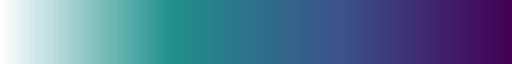

In [6]:
line_colors = ['white', '#21908C', '#3B528B', '#440154']
cmapd = mcolors.LinearSegmentedColormap.from_list("custom_colormap", line_colors, N=256)
cmapd

/home/a/a270229/.conda/envs/mypython/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'm'
  result = super().contourf(*args, **kwargs)
/home/a/a270229/.conda/envs/mypython/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'm'
  result = super().contourf(*args, **kwargs)
/home/a/a270229/.conda/envs/mypython/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'm'
  result = super().contourf(*args, **kwargs)
/home/a/a270229/.conda/envs/mypython/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'm'
  result = super().contourf(*args, **kwargs)
/home/a/a270229/.conda/envs/mypython/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'm'
  result = super().contou

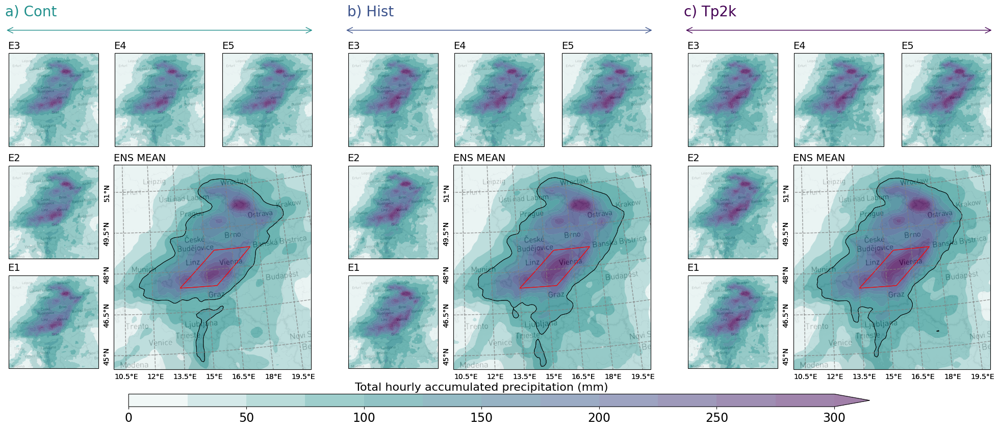

In [7]:
# Custom Mapbox tile provider
class MapboxTiles(cimgt.GoogleWTS):
    def __init__(self, access_token):
        self.access_token = access_token
        super().__init__(desired_tile_form='RGB')

    def _image_url(self, tile):
        x, y, z = tile
        url = (
            f"https://api.mapbox.com/styles/v1/amjohn001/clxube9ta00a701pa1jqx1vov/"
            f"tiles/256/{z}/{x}/{y}@2x?access_token={self.access_token}"
        )
        return url

# Mapbox access token
mapbox_access_token = 'pk.eyJ1IjoiYW1qb2huMDAxIiwiYSI6ImNsemI0YzN4cTAybjYya3M1N2R1Z3ZqbHYifQ.scte4U2UBYCcG0MyRquYyQ'
mapbox_tiles = MapboxTiles(access_token=mapbox_access_token)

# --- Overall Figure Setup ---
fig = plt.figure(figsize=(25, 9))  # Wider figure for three sets
overall_grid = gridspec.GridSpec(2, 3, wspace=0.1, hspace=0.15, height_ratios=[1.0, 0.04])  # Space for colorbar
# overall_grid = gridspec.GridSpec(2, 3, wspace=0.1, hspace=0.15, height_ratios=[1.0, 0.04])

titles = ["E1", "E2", "E3", "E4", "E5", "ENS MEAN"]

def create_layout_set(overall_grid_position, set_title, set_number):
    set_grid = gridspec.GridSpecFromSubplotSpec(
        3, 3, subplot_spec=overall_grid_position, wspace=0.1, hspace=0.2
    )

    projection = ccrs.EuroPP()
    
    axes = [
        fig.add_subplot(set_grid[2, 0], projection=projection),  # E1 (bottom-left)
        fig.add_subplot(set_grid[1, 0], projection=projection),  # E2
        fig.add_subplot(set_grid[0, 0], projection=projection),  # E3
        fig.add_subplot(set_grid[0, 1], projection=projection),  # E4
        fig.add_subplot(set_grid[0, 2], projection=projection),  # E5 (top-right)
        fig.add_subplot(set_grid[1:, 1:], projection=projection)  # ENS MEAN
    ]

    # Get ensemble plot position first
    ensemble_pos = axes[5].get_position()
    
    # Adjust individual plot positions
    # E1: Align bottom with ensemble bottom
    e1_pos = axes[0].get_position()
    axes[0].set_position([e1_pos.x0, ensemble_pos.y0, e1_pos.width, e1_pos.height])
    
    # E2: Align top with ensemble top
    e2_pos = axes[1].get_position()
    new_e2_y0 = ensemble_pos.y1 - e2_pos.height
    axes[1].set_position([e2_pos.x0, new_e2_y0, e2_pos.width, e2_pos.height])
    
    # E5: Align right with ensemble right
    e5_pos = axes[4].get_position()
    new_e5_x0 = ensemble_pos.x1 - e5_pos.width
    axes[4].set_position([new_e5_x0, e5_pos.y0, e5_pos.width, e5_pos.height])

    titles = ["E1", "E2", "E3", "E4", "E5", "ENS MEAN"]
    for i, (ax, title) in enumerate(zip(axes, titles)):
        ax.set_aspect('equal')
        add_cartopy_plot(ax, data_sets[set_number-1][i], europe_extent, show_ticks=(i == 5))
        
        if i<5:
            ax.annotate(title, xy=(0.06, 1.05), xycoords='axes fraction', ha='center', fontsize=14)
        else:
            ax.annotate(title, xy=(0.13, 1.02), xycoords='axes fraction', ha='center', fontsize=14)

    # color = {'Cont': 'green', 'Hist': 'blue', 'Tp2k': 'red'}[set_title]
    color = {'a) Cont': '#21908C', 'b) Hist': '#3B528B', 'c) Tp2k': '#440154'}[set_title]
    # colors = ['#21908C', '#3B528B', '#440154'] 
    # axes[2].annotate(set_title, xy=(0.5, 1.4), xycoords='axes fraction', ha='center', 
    #                 fontsize=18, color=color, fontweight='bold')
    axes[2].annotate(set_title, xy=(0.25, 1.4), xycoords='axes fraction', ha='center', 
                    fontsize=20, color=color)

    # Arrow positioning
    x_start = overall_grid_position.get_position(fig).x0
    x_end = overall_grid_position.get_position(fig).x1
    y = overall_grid_position.get_position(fig).y1 + 0.05
    
    arrow = FancyArrowPatch(
        (x_start, y), (x_end, y),
        arrowstyle='<->', mutation_scale=20,
        color=color, clip_on=False,
        transform=fig.transFigure
    )
    fig.patches.append(arrow)

    return axes

# --- Define Europe region ---
europe_extent = [10, 20, 44.5, 51.5]  # [min_lon, max_lon, min_lat, max_lat]

from matplotlib.colors import BoundaryNorm

def add_cartopy_plot(ax, data, extent, show_ticks=False):
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    
    # Add the Mapbox tiles to your plot
    ax.add_image(mapbox_tiles, 6)
    
    # Define levels and colormap
    # levels = np.arange(0, 376, 25)  # 0-350 in steps of 50
    levels = np.arange(0, 301, 25)
    cmap = cmapd #plt.get_cmap('terrain_r')
    
    # Create BoundaryNorm with extended upper limit
    norm = BoundaryNorm(levels, ncolors=cmap.N, extend='max')
    
    # Plot data with contourf
    contours = ax.contourf(data.lon, data.lat, data, 
                          transform=ccrs.PlateCarree(),
                          alpha=0.5, cmap=cmapd, 
                          m=norm, antialiased=True,
                          levels=levels,
                          extend='max')
    

    # Add polygon for Ensemble mean plot
    if show_ticks:
        polygon_coords = [
            [13.5, 47.4],  # Bottom-left corner
            [15.5, 47.4],  # Bottom-right corner
            [17.5, 48.7],  # Top-right corner
            [15.5, 48.7],  # Top-left corner
            [13.5, 47.4]   # Close the polygon
        ]
        ax.add_geometries([Polygon(polygon_coords)], crs=ccrs.PlateCarree(), 
                        facecolor='none', edgecolor='red', linewidth=0.7)



        # Add black contour line for values > 150
        cs = ax.contour(data.lon, data.lat, data,
                   transform=ccrs.PlateCarree(),
                   levels=[100],  # Single contour at 150
                   colors='black',
                   linewidths=0.6,
                   linestyles='-')


    # Add gridlines and labels if show_ticks is True
    if show_ticks:
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                        linewidth=1, color='gray', alpha=0.5, linestyle='--')
        gl.top_labels = False
        gl.right_labels = False
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.ylabel_style = {'rotation': 90}

    return contours


# --- Add Cartopy plots to each set ---
data_sets = [
    [dac1, dac2, dac3, dac4, dac5, EmnC],
    [dah1, dah2, dah3, dah4, dah5, EmnH],
    [da21, da22, da23, da24, da25, Emn2]
]

# --- Create the layout sets ---
axes_set1 = create_layout_set(overall_grid[0, 0], 'a) Cont', 1)
axes_set2 = create_layout_set(overall_grid[0, 1], 'b) Hist', 2)
axes_set3 = create_layout_set(overall_grid[0, 2], 'c) Tp2k', 3)

for axes, data_set in zip([axes_set1, axes_set2, axes_set3], data_sets):
    for i, (ax, data) in enumerate(zip(axes, data_set)):
        contour = add_cartopy_plot(ax, data, europe_extent, show_ticks=(i == 5))  # Only ENS MEAN (i==5) gets ticks

# Use the contour from the last plot for the colorbar
contour_for_colorbar = contour

# --- Add a common colorbar ---
colorbar_grid = gridspec.GridSpecFromSubplotSpec(1, 3, subplot_spec=overall_grid[1, :], wspace=0.0, width_ratios=[1, 6, 1])  # Adjust width_ratios
ax_colorbar = fig.add_subplot(colorbar_grid[0, 1])  # Centered colorbar

cbar = fig.colorbar(contour_for_colorbar, cax=ax_colorbar, orientation='horizontal', pad=0.25, shrink=0.7, extend='max')
# cbar.set_label('Total hourly accumulated precipitation (mm)', fontsize=16, labelpad=-1)
# cbar.ax.tick_params(labelsize=17) 

cbar.set_label('Total hourly accumulated precipitation (mm)', fontsize=16, labelpad=5)
cbar.ax.xaxis.set_label_position('top')
cbar.ax.tick_params(labelsize=17)

# --- Save and show the plot ---
# plt.savefig(f"{plotpath}F8_a.png", dpi=500, bbox_inches='tight')
plt.show()


<div style="border: 2px solid #00ff40; background-color: #000000; color: white; padding: 20px; border-radius: 5px;">

Hourly time-series of the precipitation recieved in the red box

---
---
  
</div>

In [34]:
def mask_data_with_polygon(data, lon, lat, polygon_coords, debug=False):
    """
    Masks the input data using a polygonal region.
    
    Parameters:
    - data (xarray.DataArray): The data to be masked.
    - lon (xarray.DataArray): Longitude values.
    - lat (xarray.DataArray): Latitude values.
    - polygon_coords (list of tuples): Polygon coordinates [(lon1, lat1), (lon2, lat2), ...].
    - debug (bool): If True, plots the mask for verification.

    Returns:
    - mask (numpy.ndarray): Boolean mask where True indicates inside the polygon.
    - masked_data (xarray.DataArray): Data with values outside the polygon set to NaN.
    """
    
    # Ensure correct indexing for lon-lat meshgrid
    lon_vals, lat_vals = np.meshgrid(lon.values, lat.values, indexing="xy")

    # Create polygon object
    polygon = Polygon(polygon_coords)

    # Create a boolean mask by checking which points are inside the polygon
    mask = np.array([polygon.contains(Point(lon, lat)) for lon, lat in zip(lon_vals.flatten(), lat_vals.flatten())])
    mask = mask.reshape(lon_vals.shape)

    # Apply the mask to the data
    masked_data = data.where(mask)

    # Debugging: Plot the mask if requested
    if debug:
        plt.figure(figsize=(6, 6))
        plt.imshow(mask, origin="lower", extent=[lon.min(), lon.max(), lat.min(), lat.max()], cmap="gray")
        plt.colorbar(label="Mask (1 = Inside, 0 = Outside)")
        plt.scatter(*zip(*polygon_coords), color="red", label="Polygon")
        plt.legend()
        plt.title("Mask Visualization")
        plt.show()

    return mask, masked_data

In [35]:
# Define configurations
experiments = ['cont', 'hist', '2k']
members = ['ENSMEAN'] + [f'E{i}' for i in range(1, 6)]

# Create data containers
datasets = {}
data = {}

# Load and process data
for member in members:
    datasets[member] = {}
    data[member] = {}
    
    for exp in experiments:
        # Construct file path
        path = (
            f"/work/ab0995/a270229/work/data/paper1/story-nudged/data/events/FLD/"
            f"MODELS/IFS-FESOM/{exp}/Boris/ppr_rev/228/{member}/"
            f"TP_IFS-FESOM_sfc_20240912-20240916_EUR_9.nc"
        )
        
        # Load dataset
        datasets[member][exp] = xr.open_dataset(path)
        
        # Process precipitation data (convert m to mm)
        data[member][exp] = datasets[member][exp]['tp'] * 1000


In [36]:
# Define regions
regions = {
    'R': [(13.5, 47.4), (15.5, 47.4), (17.5, 48.7), (15.5, 48.7)],
    'G': [(17.9, 50.1), (17.3, 50.6), (15.5, 49.9), (15.8, 49.5)]
}

# Create storage dictionaries
masks = {}
masked_data = {}

for member in members:
    masks[member] = {}
    masked_data[member] = {}
    
    for exp in experiments:
        masks[member][exp] = {}
        masked_data[member][exp] = {}
        
        # Get the DataArray for this member/experiment
        da = data[member][exp]
        
        for region_name, coords in regions.items():
            # Apply masking
            mask, msk_tp = mask_data_with_polygon(da, da.lon, da.lat, coords, debug=False)
            
            # Store results
            masks[member][exp][region_name] = mask
            masked_data[member][exp][region_name] = msk_tp


In [37]:
# =============================================
# Data Processing
# =============================================
def create_region_dataframe(region):
    """Create DataFrame for a specific region."""
    data_dict = {}
    
    for exp, prefix in zip(experiments, ['Cont', 'Hist', 'Tp2K']):
        # Ensemble mean (ENSMEAN)
        data_dict[prefix] = (
            masked_data['ENSMEAN'][exp][region]
            .mean(dim=['lat', 'lon'])
            .to_series()
        )
        
        # Individual members (E1-E5)
        for i in range(1, 6):
            member = f'E{i}'
            data_dict[f'{prefix}{i}'] = (
                masked_data[member][exp][region]
                .mean(dim=['lat', 'lon'])
                .to_series()
            )
    
    return pd.DataFrame(data_dict)

# Create DataFrames for both regions
dfr = create_region_dataframe('R')
dfg = create_region_dataframe('G')

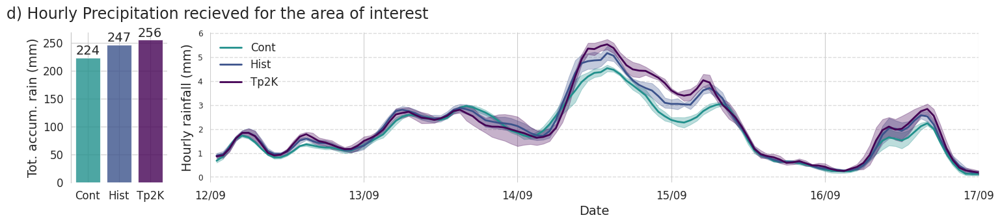

In [12]:
# =============================================
# Time Filtering and Cumulative Calculation
# =============================================
start_time = pd.Timestamp('2024-09-12 00:00')
end_time = pd.Timestamp('2024-09-17 00:00')  # Extend end time to September 17
df_filtered = dfr[start_time:end_time]
df_accumulated = df_filtered.cumsum()
total_rainfall = df_accumulated[['Cont', 'Hist', 'Tp2K']].iloc[-1]

# Set Seaborn style
sns.set(style="whitegrid")
sns.set_context("paper")

# Define colors and labels
colors = ['#21908C', '#3B528B', '#440154']  
labels = ['Cont', 'Hist', 'Tp2K']

# Create the figure with two subplots
fig, (ax_bar, ax_line) = plt.subplots(1, 2, figsize=(18, 3), gridspec_kw={'width_ratios': [1, 8], 'wspace': 0.1})

# =============================================
# Bar Chart (Ensemble Means)
# =============================================
bar_positions = range(len(labels))
ax_bar.bar(bar_positions, total_rainfall.values, color=colors, alpha=0.8, width=0.8)

# Customize bar chart appearance
ax_bar.set_xticks(bar_positions)
ax_bar.set_xticklabels(labels, fontsize=12)
ax_bar.set_ylabel('Tot. accum. rain (mm)', fontsize=14)
ax_bar.tick_params(axis='y', labelsize=12)
ax_bar.spines['top'].set_visible(False)
ax_bar.spines['right'].set_visible(False)
ax_bar.spines['bottom'].set_visible(False)
ax_bar.set_xticklabels(['Cont', 'Hist', 'Tp2K'])

# Add total values above bars
for i, value in enumerate(total_rainfall):
    ax_bar.text(i, value + 5, f"{value:.0f}", ha='center', fontsize=14)
    
# =============================================
# Time Series Plot (Ensemble Members)
# =============================================
def plot_ensemble_members(ax, df, labels, colors, members=True):
    for label, color in zip(labels, colors):
        ensemble_columns = [f"{label}{i}" for i in range(1, 6)]
        
        if all(col in df.columns for col in ensemble_columns):
            # Plot individual members with shading
            if members:
                ensemble_data = df[ensemble_columns]
                mean = ensemble_data.mean(axis=1)
                std = ensemble_data.std(axis=1)
                ax.fill_between(df.index, mean - std, mean + std, color=color, alpha=0.3)
        
        # Plot ensemble means with full opacity
        if label in df.columns:
            if not df[label].isnull().all():
                ax.plot(df.index, df[label], color=color, label=label, linewidth=2.0)
            else:
                print(f"Warning: {label} contains only NaN values.")
        else:
            print(f"Warning: {label} not found in DataFrame columns.")

# Create the line plot
ax_line_left = ax_line
ax_line_right = ax_line_left #.twinx()

# Plot data on both axes with shading
plot_ensemble_members(ax_line_left, dfr, ['Cont', 'Hist', 'Tp2K'], colors, members=True)

# Customize line plot appearance
for ax in [ax_line_left, ax_line_right]:
    ax.set_facecolor('white')
    ax.spines['top'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    # ax.tick_params(axis='y', labelsize=12)
    ax.tick_params(axis='x', labelsize=12)

ax_line_left.spines['right'].set_visible(False)
ax_line_right.spines['left'].set_visible(False)

# Format x-axis for line plot
ax_line_left.xaxis.set_major_locator(mdates.DayLocator())
ax_line_left.xaxis.set_major_formatter(mdates.DateFormatter('%d/%m'))
plt.setp(ax_line_left.xaxis.get_majorticklabels(), rotation=0)

# Set axis limits and labels for line plot
ax_line_left.set_xlim([start_time, end_time])
ax_line_left.set_xlabel('Date', fontsize=14)
ax_line_left.set_ylabel('Hourly rainfall (mm)', fontsize=14)

# Add legend to line plot
lines_left, labels_left = ax_line_left.get_legend_handles_labels()
ax_line_left.legend(lines_left, labels_left, fontsize=12, loc='upper left', frameon=False)

# Add horizontal dashed grid lines
ax_line_left.yaxis.grid(True, linestyle='--', linewidth=1, alpha=0.7)
fig.text(0.07, 0.95, 'd) Hourly Precipitation recieved for the area of interest', fontsize=17)

plt.savefig(f"{plotpath}F8_b.png", dpi=650, bbox_inches='tight')
plt.show()


/tmp/ipykernel_2764801/300363938.py:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_labels, y=ensemble_data, palette=colors, ax=ax_box, width=0.3, medianprops=dict(color='grey', linewidth=1))
/tmp/ipykernel_2764801/300363938.py:47: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax_box.set_xticklabels(labels, fontsize=12)


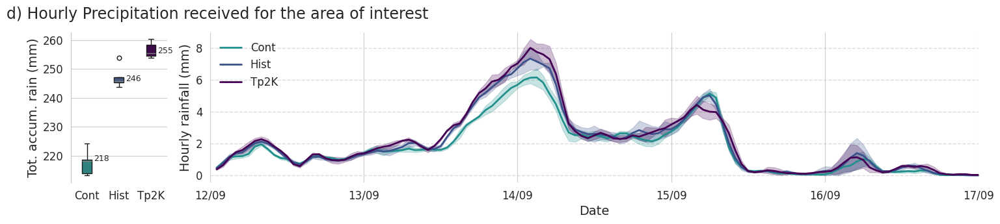

In [12]:
# =============================================
# Time Filtering and Cumulative Calculation
# =============================================
start_time = pd.Timestamp('2024-09-12 00:00')
end_time = pd.Timestamp('2024-09-17 00:00')  # Extend end time to September 17
df_filtered = dfg[start_time:end_time]
df_accumulated = df_filtered.cumsum()
total_rainfall = df_accumulated[['Cont', 'Hist', 'Tp2K']].iloc[-1]

# Set Seaborn style
sns.set(style="whitegrid")
sns.set_context("paper")

# Define colors and labels
colors = ['#21908C', '#3B528B', '#440154']  
labels = ['Cont', 'Hist', 'Tp2K']

# Create the figure with two subplots
fig, (ax_box, ax_line) = plt.subplots(1, 2, figsize=(18, 3), gridspec_kw={'width_ratios': [1, 8], 'wspace': 0.1})

# =============================================
# Box Plot (Ensemble Members at Final Time Step)
# =============================================
ensemble_data = []
group_labels = []

for label, color in zip(labels, colors):
    ensemble_members = [f"{label}{i}" for i in range(1, 6)]
    if all(col in df_accumulated.columns for col in ensemble_members):
        final_values = df_accumulated[ensemble_members].iloc[-1].values
        ensemble_data.extend(final_values)
        group_labels.extend([label] * len(final_values))
    else:
        print(f"Warning: Missing ensemble members for {label}")

# Create boxplot
sns.boxplot(x=group_labels, y=ensemble_data, palette=colors, ax=ax_box, width=0.3, medianprops=dict(color='grey', linewidth=1))

# Customize appearance
ax_box.set_ylabel('Tot. accum. rain (mm)', fontsize=14)
ax_box.set_xlabel('')
ax_box.set_xticklabels(labels, fontsize=12)
ax_box.tick_params(axis='y', labelsize=12)
ax_box.spines['top'].set_visible(False)
ax_box.spines['right'].set_visible(False)
ax_box.spines['bottom'].set_visible(False)

# Annotate median values
medians = df_accumulated[[f"{label}{i}" for label in labels for i in range(1, 6)]].iloc[-1].groupby(lambda x: x[:-1]).median()
for i, label in enumerate(labels):
    median = medians[label]
    offset = -0.05
    ax_box.text(i+0.45, median + offset, f"{median:.0f}", ha='center', fontsize=9) #weight='bold'

# =============================================
# Time Series Plot (Ensemble Members)
# =============================================
def plot_ensemble_members(ax, df, labels, colors, members=True):
    for label, color in zip(labels, colors):
        ensemble_columns = [f"{label}{i}" for i in range(1, 6)]
        
        if all(col in df.columns for col in ensemble_columns):
            if members:
                ensemble_data = df[ensemble_columns]
                mean = ensemble_data.mean(axis=1)
                std = ensemble_data.std(axis=1)
                ax.fill_between(df.index, mean - std, mean + std, color=color, alpha=0.25)
        
        # Plot ensemble mean
        if label in df.columns:
            if not df[label].isnull().all():
                ax.plot(df.index, df[label], color=color, label=label, linewidth=2.0)
            else:
                print(f"Warning: {label} contains only NaN values.")
        else:
            print(f"Warning: {label} not found in DataFrame columns.")

# Create the line plot
ax_line_left = ax_line
ax_line_right = ax_line_left  # No secondary y-axis

# Plot shaded ensemble spread and mean line
plot_ensemble_members(ax_line_left, dfg, labels, colors, members=True)

# Customize line plot
for ax in [ax_line_left, ax_line_right]:
    ax.set_facecolor('white')
    ax.spines['top'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.tick_params(axis='x', labelsize=12)

    ax.tick_params(axis='y', labelsize=12)

ax_line_left.spines['right'].set_visible(False)
ax_line_right.spines['left'].set_visible(False)

# Format x-axis
ax_line_left.xaxis.set_major_locator(mdates.DayLocator())
ax_line_left.xaxis.set_major_formatter(mdates.DateFormatter('%d/%m'))
plt.setp(ax_line_left.xaxis.get_majorticklabels(), rotation=0)

# Axis limits and labels
ax_line_left.set_xlim([start_time, end_time])
ax_line_left.set_xlabel('Date', fontsize=14)
ax_line_left.set_ylabel('Hourly rainfall (mm)', fontsize=14)

# Legend
lines_left, labels_left = ax_line_left.get_legend_handles_labels()
ax_line_left.legend(lines_left, labels_left, fontsize=12, loc='upper left', frameon=False)

# Grid
ax_line_left.yaxis.grid(True, linestyle='--', linewidth=1, alpha=0.7)

# Add plot label
fig.text(0.07, 0.95, 'd) Hourly Precipitation received for the area of interest', fontsize=17)

# Save and show
# plt.savefig(f"{plotpath}F8_b_box.png", dpi=650, bbox_inches='tight')
plt.show()


In [56]:
from IPython.display import Image

In [10]:
Image(filename=f'{plotpath}/Storyline_Boris_with_hourtly_TS.png')

In [57]:
Image(filename=f'{plotpath}/Storyline_Boris_with_hourtly_TS_1.png')

# Compute area

In [7]:
Ccrop =  EmnC#.sel(lon=slice(10, 20), lat=slice(51.5, 44.25))#sel(lon=slice(10, 20), lat=slice(51.5, 44.5))
Hcrop =  EmnH#.sel(lon=slice(10, 20), lat=slice(51.5, 44.25))#sel(lon=slice(10, 20), lat=slice(51.5, 44.5))
Tcrop =  Emn2#.sel(lon=slice(10, 20), lat=slice(51.5, 44.25))#sel(lon=slice(10, 20), lat=slice(51.5, 44.5))
Hcrop.count()

<xarray.DataArray 'tp' ()> Size: 8B
array(175851)

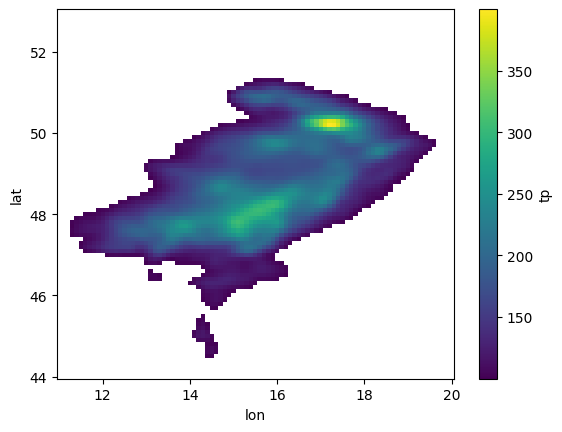

In [23]:
h100.sel(lon=slice(11, 20), lat=slice(53, 44.)).plot()

In [8]:
c100 = xr.where(Ccrop>=100,Ccrop,np.nan)
h100 = xr.where(Hcrop>=100,Hcrop,np.nan)
t100 = xr.where(Tcrop>=100,Tcrop,np.nan)

In [9]:
c=(c100.count()/Hcrop.count())*100
h=(h100.count()/Hcrop.count())*100
t=(t100.count()/Hcrop.count())*100

In [10]:
print(((h100.count()-c100.count())/c100.count())*100)
print(((t100.count()-h100.count())/h100.count())*100)
print(((t100.count()-c100.count())/c100.count())*100)

<xarray.DataArray 'tp' ()> Size: 8B
array(19.44696283)
<xarray.DataArray 'tp' ()> Size: 8B
array(3.52941176)
<xarray.DataArray 'tp' ()> Size: 8B
array(23.66273799)


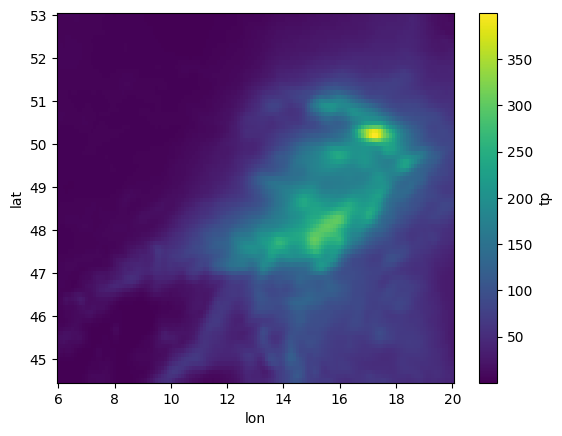

In [170]:
EmnH.sel(lon=slice(6, 20), lat=slice(53, 44.5)).plot()

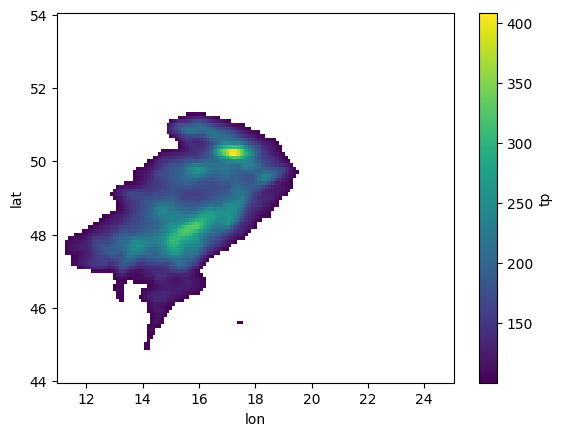

In [313]:
# h100.sel(lon=slice(11, 20), lat=slice(52, 44)).plot()
# h100.sel(lon=slice(10, 20), lat=slice(51.5, 44.25)).plot()
t100.sel(lon=slice(11, 25), lat=slice(54, 44)).plot()

In [25]:
def calculate_percentage_change(data1, data2, contour_min, contour_max):
    """
    Calculate the percentage change in the number of grid cells 
    within a specified contour range between two datasets.

    Parameters:
    - data1: First dataset (2D array)
    - data2: Second dataset (2D array)
    - contour_min: Minimum value of the contour range
    - contour_max: Maximum value of the contour range

    Returns:
    - num_cells_data1: Number of grid cells in the range for dataset 1
    - num_cells_data2: Number of grid cells in the range for dataset 2
    - percentage_change: Percentage change between the two datasets
    """
    
    # Create a mask to identify grid cells within the contour range for each dataset
    mask1 = (data1 >= contour_min) & (data1 <= contour_max)
    mask2 = (data2 >= contour_min) & (data2 <= contour_max)
    
    # Count the number of grid cells inside the range
    num_cells_data1 = np.sum(mask1)
    num_cells_data2 = np.sum(mask2)
    
    # Calculate the percentage change
    if num_cells_data1 == 0:
        percentage_change = float('inf')  # Avoid division by zero
    else:
        percentage_change = ((num_cells_data2 - num_cells_data1) / num_cells_data1) * 100
    
    return num_cells_data1, num_cells_data2, percentage_change

In [28]:
num_cells_data1, num_cells_data2, percentage_change=calculate_percentage_change(EmnC.sel(lon=slice(11, 20), lat=slice(53, 44)),
                                                                                EmnH.sel(lon=slice(11, 20), lat=slice(53, 44)), 
                                                                                100, 1000)
print(f"Percentage change (cont to hist): {percentage_change:.1f}%")

num_cells_data1, num_cells_data2, percentage_change=calculate_percentage_change(EmnH.sel(lon=slice(11, 20), lat=slice(53, 44)),
                                                                                Emn2.sel(lon=slice(11, 20), lat=slice(53, 44)), 
                                                                                100, 1000)
print(f"Percentage change (hist to 2k): {percentage_change:.1f}%")



num_cells_data1, num_cells_data2, percentage_change=calculate_percentage_change(EmnC,
                                                                                EmnH, 
                                                                                100, 1000)
print(f"Percentage change (cont to hist): {percentage_change:.1f}%")

nnum_cells_data1, num_cells_data2, percentage_change=calculate_percentage_change(EmnH,
                                                                                 Emn2, 
                                                                                100, 1000)
print(f"Percentage change (hist to 2k): {percentage_change:.1f}%")

Percentage change (cont to hist): 16.5%
Percentage change (hist to 2k): 2.6%
Percentage change (cont to hist): 19.4%
Percentage change (hist to 2k): 3.5%


In [255]:
num_cells_data1, num_cells_data2, percentage_change=calculate_percentage_change(EmnC,EmnH, 
                                                                                100, 1000)
print(f"Percentage change (cont to hist): {percentage_change:.1f}%")

num_cells_data1, num_cells_data2, percentage_change=calculate_percentage_change(EmnH,Emn2, 
                                                                                100, 1000)
print(f"Percentage change (hist to 2k): {percentage_change:.1f}%")

Percentage change (cont to hist): 19.4%
Percentage change (hist to 2k): 3.5%
